In [1]:
import os
import requests
import zipfile
import io
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import shutil

from PIL import Image
from IPython.lib.security import random
from tqdm import tqdm

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import applications
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.optimizers import RMSprop, Adam

from keras.models import Model, Sequential
from keras.layers import Dense, Dropout, Flatten, Convolution2D, MaxPooling2D,ZeroPadding2D,BatchNormalization,GlobalAveragePooling2D
from keras.layers import Input, Lambda


import tensorflow.keras.backend as K

from keras.preprocessing.image import ImageDataGenerator

from keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint



In [14]:
# Request dataset from Github
request = requests.get('https://github.com/GuillaumeMougeot/DogFaceNet/releases/download/dataset/DogFaceNet_Dataset_224_1.zip', 'r')

# Extract contents of archive
archive = zipfile.ZipFile(io.BytesIO(request.content))
archive.extractall()

In [4]:
# Notebook config 
train_data_directory = '../content/after_4_bis/'
num_imgs = 8343
num_classes = 1393
img_width = 224
img_height = 224
img_dims = img_width, img_height
channels = 3

In [15]:
classes = os.listdir(train_data_directory)
print(len(classes))
triplets = []
labels = []

def select_random_avoiding_anchor(arr, anchor):
  temp_arr = arr.copy()
  temp_arr.pop(temp_arr.index(anchor))
  return random.choice(temp_arr)


for i in os.walk(train_data_directory):
  class_name = os.path.basename(i[0])
  class_items = i[-1]

  for anchor in class_items:

    img_path = i[0] + '/' + anchor
    positive = select_random_avoiding_anchor(class_items,anchor)

    negative_path = train_data_directory + select_random_avoiding_anchor(classes,class_name)
    negative = negative_path.split('/')[-1] + '/' + random.choice(os.listdir(negative_path))

    if(anchor.split('.')[0] == class_name and positive.split('.')[0] == class_name):
      triplets.append((class_name + '/' + anchor, class_name + '/' +  positive,negative))
      labels.append(class_name)

assert len(triplets) == len(labels)
assert all(x[0] != x[1] for x in triplets)
assert all(labels[i] == triplets[i][0].split('/')[0].split('.')[0] for i in range(len(labels)))
assert all(labels[i] == triplets[i][1].split('/')[0].split('.')[0] for i in range(len(labels)))
assert all(labels[i] != triplets[i][2].split('/')[0].split('.')[0] for i in range(len(labels)))

print(len(triplets))


1393
8343


In [16]:
def img_path_to_tensor(path):
  if path.endswith('.jpg'):
    # Load RGB image 
    img = Image.open(path).convert("RGB")

    # Resize image to specified image dimensions
    img = img.resize(img_dims,Image.ANTIALIAS)

    # Rescale the image
    img = np.array(img)/255

    # Convert tensor to 4D
    img = np.expand_dims(img, 0)

    # print(img.shape)
    # plt.imshow(img[0])
    # plt.show()

  return img

In [17]:
anchors = []
positives = []
negatives = []
data_labels = []

for i in tqdm(range(1000)):

  triplet = triplets[i]
  anchor_path = train_data_directory + triplet[0]
  positive_path = train_data_directory + triplet[1]
  negative_path = train_data_directory + triplet[2]

  anchors.append(img_path_to_tensor(anchor_path))
  positives.append(img_path_to_tensor(positive_path))
  negatives.append(img_path_to_tensor(negative_path))
  data_labels.append(labels[i])






100%|██████████| 1000/1000 [00:05<00:00, 167.16it/s]


In [18]:
anchors = np.concatenate(anchors)
positives = np.concatenate(positives)
negatives = np.concatenate(negatives)

792
(224, 224, 3)


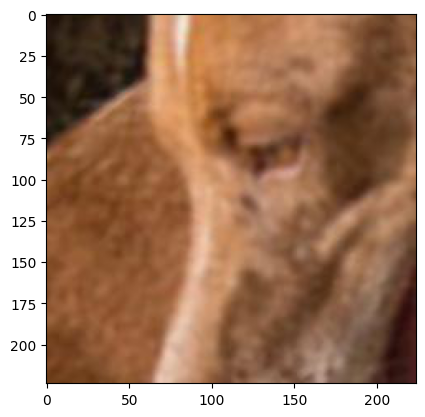

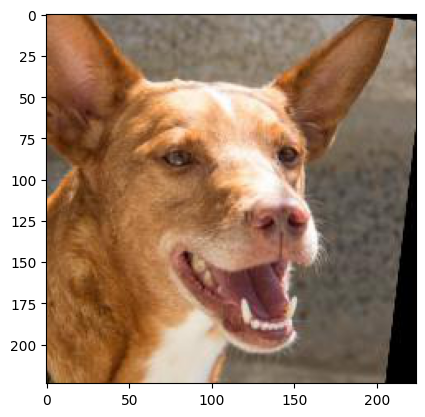

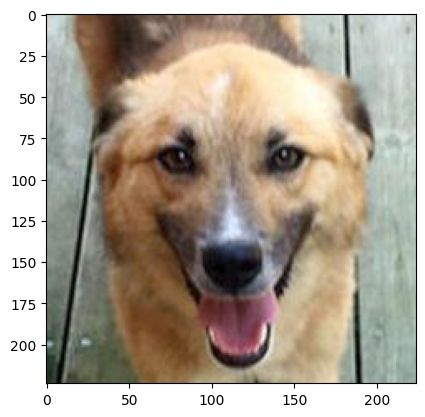

In [8]:
print(labels[55])
print(anchors[55].shape)
plt.imshow(anchors[60])
plt.show()

plt.imshow(positives[60])
plt.show()

plt.imshow(negatives[60])
plt.show()

In [19]:
train_datagen = ImageDataGenerator(rescale=1/255,validation_split=0.1) # set validation split

from sklearn.model_selection import train_test_split
X_train_anchors, X_test_anchors, y_train, y_test = train_test_split(anchors, data_labels,
                                                    stratify=None, 
                                                    test_size=0.10, shuffle=False)

X_train_positives, X_test_positives, y_train, y_test = train_test_split(positives, data_labels,
                                                    stratify=None, 
                                                    test_size=0.10, shuffle=False)

X_train_negatives, X_test_negatives, y_train, y_test = train_test_split(negatives, data_labels,
                                                    stratify=None, 
                                                    test_size=0.10, shuffle=False)

# print(y_train[55])
# plt.imshow(X_train_anchors[55])
# plt.show()


# plt.imshow(X_train_positives[55])
# plt.show()

# plt.imshow(X_train_negatives[55])
# plt.show()


# plt.imshow(X_test_anchors[55])
# plt.show()


# plt.imshow(X_test_positives[55])
# plt.show()

# plt.imshow(X_test_negatives[55])
# plt.show()









In [20]:
print(X_train_anchors[0].shape)
print(X_test_anchors.shape)

print(X_train_positives.shape)
print(X_test_positives.shape)

print(X_train_negatives.shape)
print(X_test_negatives.shape)

(224, 224, 3)
(100, 224, 224, 3)
(900, 224, 224, 3)
(100, 224, 224, 3)
(900, 224, 224, 3)
(100, 224, 224, 3)


In [21]:
def triplet_loss_layer(y_pred, alpha = 0.2):
    anchor, positive, negative = y_pred
    # distance between anchor + positive and anchor + negative tensors
    positiveDelta = K.sum(K.square(anchor-positive),axis=1)
    negativeDelta = K.sum(K.square(anchor-negative),axis=1)
    return K.maximum(positiveDelta-negativeDelta+alpha,0.0)

def triplet_loss(y_true, y_pred, alpha=0.2):
    anchor, positive, negative = y_pred[:,0,:], y_pred[:,1,:], y_pred[:,2,:]
    positiveDelta = K.sum(K.square(anchor-positive),axis=1)
    negativeDelta = K.sum(K.square(anchor-negative),axis=1)
    return K.maximum(positiveDelta-negativeDelta+alpha,0.0)

def embed_transfer_learning_model():
  # Simple convolutional model 
  InceptionV3 = applications.InceptionV3(include_top= False, input_shape= (img_width, img_height, channels), weights= 'imagenet')

  model = Sequential()

  for layer in InceptionV3.layers:
      layer.trainable= False
  #     print(layer,layer.trainable)
      
  model.add(InceptionV3)
  model.add(Dropout(0.7))
  # model.add(GlobalAveragePooling2D())
  model.add(Dense(2048, activation='softmax'))
  return model

def Siamese_Model(embed_model):
    Anchor_input = Input((img_width, img_height, channels))
    Pos_input = Input((img_width, img_height, channels))
    Neg_input = Input((img_width, img_height, channels))
        
    Anchor = embed_model(Anchor_input)
    Pos = embed_model(Pos_input)
    Neg = embed_model(Neg_input)
   
    loss = Lambda(triplet_loss_layer)([Anchor,Pos,Neg]) 
    model = Model(inputs=[Anchor_input, Pos_input, Neg_input], outputs=loss)
    model.compile(loss=triplet_loss, optimizer=Adam(0.0001), metrics=['accuracy'])
    return model

In [13]:
base_model = embed_transfer_learning_model()
model = Siamese_Model(base_model)
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_18 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_19 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_20 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                          

In [22]:
checkpoint = ModelCheckpoint(
    'dog_face_model.h5',
    monitor='val_loss',
    verbose=1,
    save_best_only=True,
    mode='auto',
    save_weights_only=False,
    period=1
)

reduce_on_p = ReduceLROnPlateau(monitor = 'val_loss', min_delta = 0.005, factor = 0.8, patience = 2, verbose = 1, mode = 'auto')

In [23]:
history = model.fit([X_train_anchors, X_train_positives, X_train_negatives], np.ones(X_train_anchors.shape[0]), epochs=10,validation_split=0.2, batch_size = 256,shuffle = True, callbacks = [checkpoint,reduce_on_p])

Epoch 1/10
3/3 [==============================] - ETA: 0s - loss: 0.1822
Epoch 1: val_loss improved from inf to 0.19994, saving model to dog_face_model.h5
3/3 [==============================] - 73s 18s/step - loss: 0.1822 - val_loss: 0.1999 - lr: 1.0000e-04
Epoch 2/10
3/3 [==============================] - ETA: 0s - loss: 0.1786
Epoch 2: val_loss improved from 0.19994 to 0.19980, saving model to dog_face_model.h5
3/3 [==============================] - 7s 3s/step - loss: 0.1786 - val_loss: 0.1998 - lr: 1.0000e-04
Epoch 3/10
3/3 [==============================] - ETA: 0s - loss: 0.1819
Epoch 3: val_loss improved from 0.19980 to 0.19957, saving model to dog_face_model.h5

Epoch 3: ReduceLROnPlateau reducing learning rate to 7.999999797903001e-05.
3/3 [==============================] - 7s 2s/step - loss: 0.1819 - val_loss: 0.1996 - lr: 1.0000e-04
Epoch 4/10
3/3 [==============================] - ETA: 0s - loss: 0.1790
Epoch 4: val_loss improved from 0.19957 to 0.19934, saving model to dog_

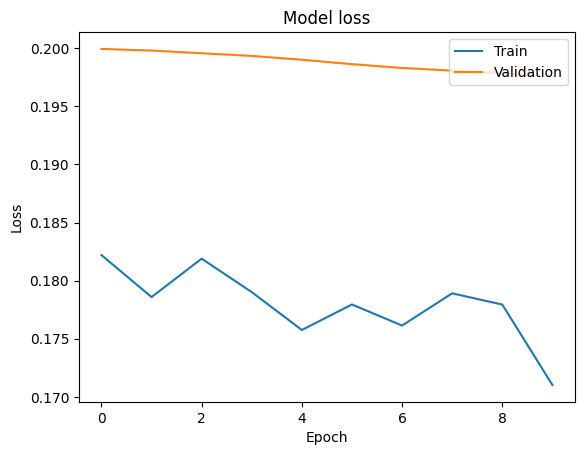

KeyError: ignored

In [24]:
# Plot training and validation loss over the epochs
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

# Plot training and validation accuracy over the epochs
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='lower right')
plt.show()

In [ ]:
model = keras.models.load_model('/content/dog_face_model_00888_val_loss.h5',custom_objects={'identity_loss':                   
identity_loss})

model.save_weights('dog_face_model_00888_val_loss_weights.hdf5')

OSError: ignored

In [13]:
A = Input((img_width, img_height, channels))
base_model = embed_transfer_learning_model()
model = base_model(A)

trained_model = Model(inputs=A, outputs=model)

# trained_model.save_model('Modified_InceptionV3_model')
trained_model.load_weights('/content/dog_face_model_00888_val_loss_weights.hdf5')

In [14]:
anchor_embeds_test = trained_model.predict(X_test_anchors)
positive_embeds_test = trained_model.predict(X_test_positives)
negative_embeds_test = trained_model.predict(X_test_negatives)


def distance(emb1, emb2):
    return np.sum(np.square(emb1 - emb2))

print(len(anchor_embeds_test))


22/22 [==============================] - 0s 18ms/step
700


<ipython-input-17-cdef657dfa17>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,3))


KeyboardInterrupt: ignored

Error in callback <function _draw_all_if_interactive at 0x7f33b50b5d80> (for post_execute):


KeyboardInterrupt: ignored

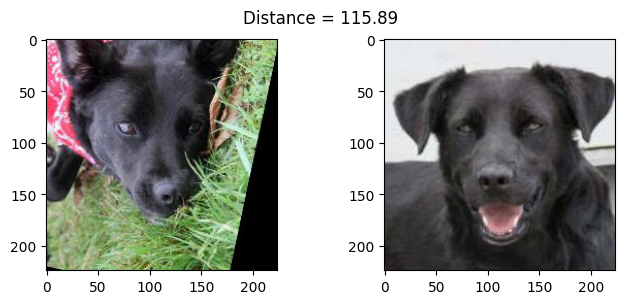

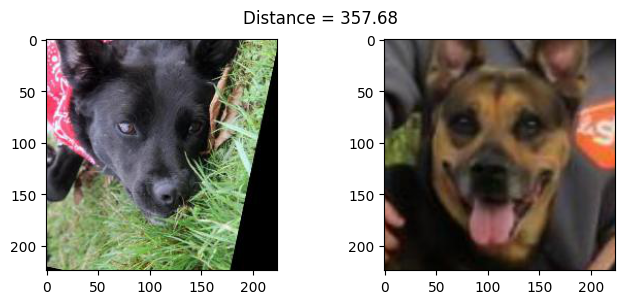

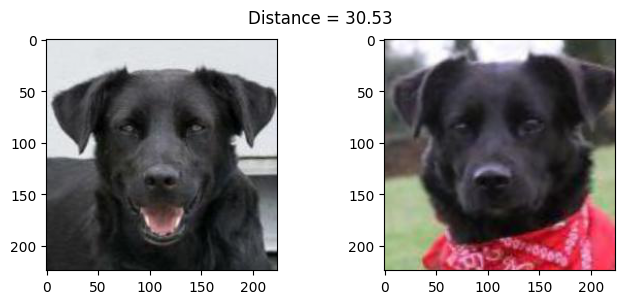

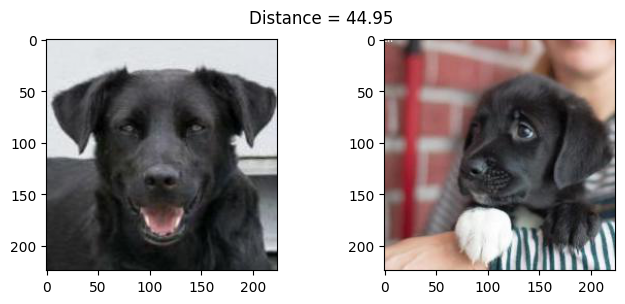

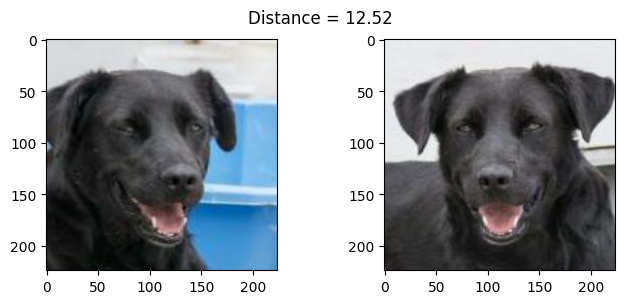

...

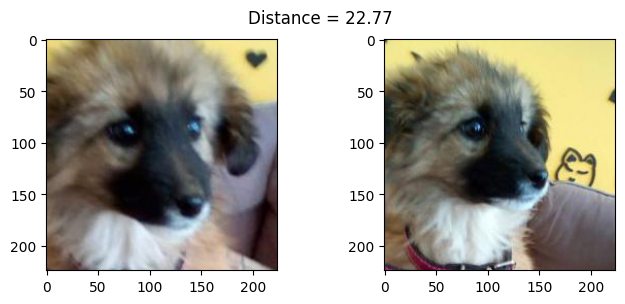

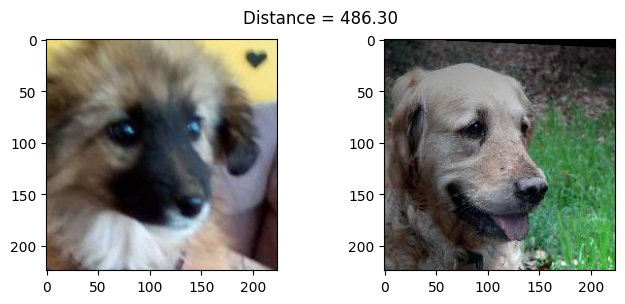

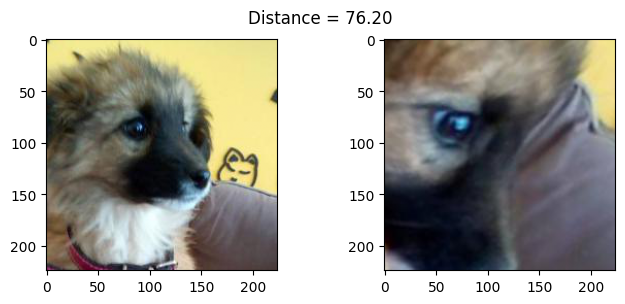

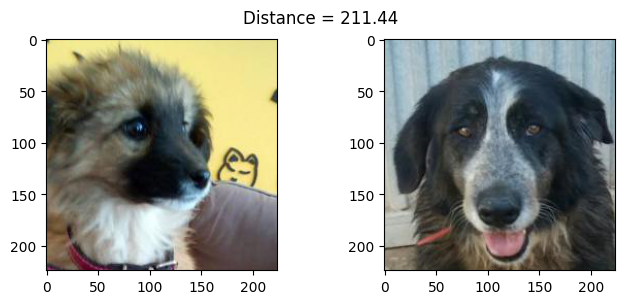

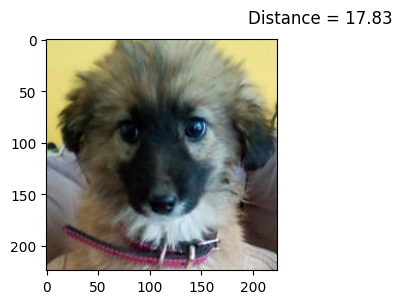

In [ ]:
pos_embed_count = 0
neg_embed_count = 0

for i in range(len(anchor_embeds_test)):
  pos_distance = distance(anchor_embeds_test[i], positive_embeds_test[i])
  neg_distance = distance(anchor_embeds_test[i], negative_embeds_test[i])

  if neg_distance < pos_distance:
    neg_embed_count +=1;
  else:
    pos_embed_count +=1;

def plot_img_pair(i, anchor_embed, anchor, embed, img):
    plt.figure(figsize=(8,3))
    plt.suptitle(f'Distance = {distance(anchor_embed, embed):.2f}')
    plt.subplot(121)
    plt.imshow(anchor)
    plt.subplot(122)
    plt.imshow(img) 


for i in range(len(anchor_embeds_test)):
  plot_img_pair(i,anchor_embeds_test[i], X_test_anchors[i], positive_embeds_test[i], X_test_positives[i])
  plot_img_pair(i,anchor_embeds_test[i], X_test_anchors[i], negative_embeds_test[i], X_test_negatives[i])



In [ ]:
acc = (pos_embed_count - neg_embed_count) / len(anchor_embeds_test)

print(len(anchor_embeds_test))

print(acc)

100
0.92


<ipython-input-62-a78275cb27e0>:25: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(embed_valid[:, 0][i], embed_valid[:, 1][i], edgecolor="black", s=75, c=colorMap[labels_valid[i]], label=labels_valid[i] if i == 0 else "", marker="^", linewidths=1)


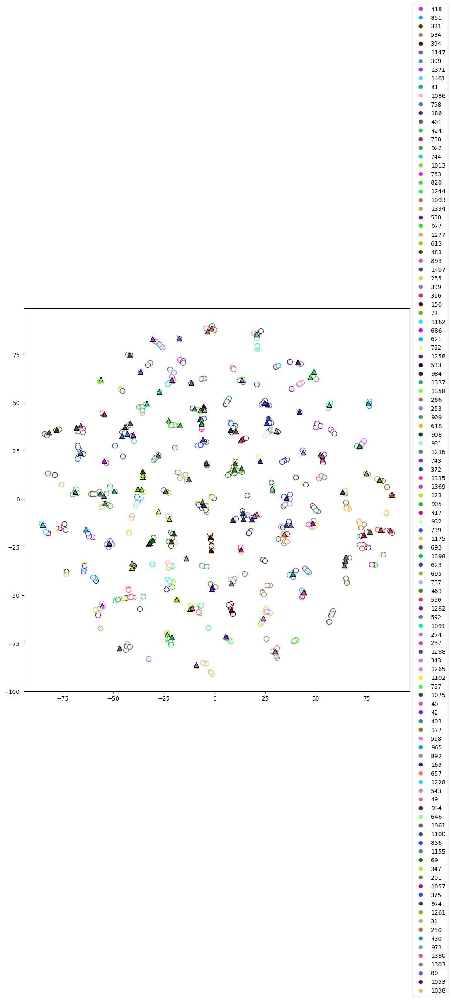

In [62]:
from sklearn.manifold import TSNE

anchor_test = anchor_embeds_test.reshape(700, 5* 5 * 2048)

transform = TSNE  # PCA
trans = transform(n_components=2, random_state=0, perplexity=1.7)
node_embeddings_2d = trans.fit_transform(anchor_test)

embed_test, embed_valid, labels_test, labels_valid = train_test_split(node_embeddings_2d, y_test, stratify=None, test_size=0.20, shuffle=True)

fig, ax = plt.subplots(figsize=(12, 12))

colorMap = {}

for label in set(labels_test):
  colorMap[label] = np.random.rand(3,)

for i in range(len(embed_test)):
  ax.scatter(embed_test[:, 0][i], embed_test[:, 1][i], edgecolor=colorMap[labels_test[i]], s=75, c="whitesmoke", label=labels_test[i] if i == 0 else "", marker="o", linewidths=1)

  # add label to point
  # ax.annotate(labels_test[i], xy=(embed_test[:, 0][i], embed_test[:, 1][i]), xytext=(10, 5), textcoords='offset points', ha='right', va='bottom', fontsize=7)

for i in range(len(embed_valid)):
  ax.scatter(embed_valid[:, 0][i], embed_valid[:, 1][i], edgecolor="black", s=75, c=colorMap[labels_valid[i]], label=labels_valid[i] if i == 0 else "", marker="^", linewidths=1)

  # add label to point
  # ax.annotate(labels_valid[i], xy=(embed_valid[:, 0][i], embed_valid[:, 1][i]), xytext=(10, 5), textcoords='offset points', ha='right', va='bottom', fontsize=7)

markers = [plt.Line2D([0,0],[0,0],color=colorMap[label], marker='o', linestyle='') for label in set(labels_test)]
ax.legend(markers, set(labels_test), loc='center left', bbox_to_anchor=(1, 0.5))

plt.savefig('plot.png', bbox_inches='tight')


plt.show()



In [103]:
from sklearn.neighbors import KNeighborsClassifier
from mlxtend.plotting import plot_decision_regions
from sklearn.metrics import f1_score, accuracy_score, precision_score, recall_score

knn = KNeighborsClassifier(n_neighbors=1, metric='euclidean')


knn.fit(embed_test, labels_test)
acc_knn = accuracy_score(labels_valid, knn.predict(embed_valid))

y_pred = knn.predict(embed_valid)

print(len(y_pred))
print(len(labels_valid))




def output_Report(numNeighbours):
  print("--------")
  print(f"Neighbors: {numNeighbours}")
  knn_n = KNeighborsClassifier(n_neighbors=numNeighbours, metric='euclidean')
  knn_n.fit(embed_test, labels_test)

  y_pred_n = knn_n.predict(embed_valid)

  print(f'Accuracy score: {accuracy_score(labels_valid, y_pred_n)}')
  print(f'F1 score: {f1_score(labels_valid, y_pred_n, average="weighted")}')
  print(f'Precision score: {precision_score(labels_valid, y_pred_n, average="weighted")}')
  print(f'Recall score: {recall_score(labels_valid, y_pred_n, average="weighted")}')

  print("--------")


output_Report(1)
output_Report(2)
output_Report(3)
output_Report(4)
output_Report(5)


140
140
--------
Neighbors: 1
Accuracy score: 0.5785714285714286
F1 score: 0.5825850340136054
Precision score: 0.6309523809523809
Recall score: 0.5785714285714286
--------
--------
Neighbors: 2
Accuracy score: 0.5
F1 score: 0.48955473098330243
Precision score: 0.5434948979591837
Recall score: 0.5
--------
--------
Neighbors: 3
Accuracy score: 0.5071428571428571
F1 score: 0.48738047666619094
Precision score: 0.5176445578231293
Recall score: 0.5071428571428571
--------
--------
Neighbors: 4
Accuracy score: 0.4785714285714286
F1 score: 0.4642503924646782
Precision score: 0.518452380952381
Recall score: 0.4785714285714286
--------
--------
Neighbors: 5
Accuracy score: 0.42857142857142855
F1 score: 0.4037175126460841
Precision score: 0.43547619047619046
Recall score: 0.42857142857142855
--------


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall

In [104]:
from sklearn import metrics

def plot_confusion_matrix():
    y_true = labels_valid

    confusion_matrix = metrics.confusion_matrix(y_true, y_pred)

    labels = list(set(y_true) | set(y_pred))
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix=confusion_matrix, display_labels=labels)

    fig, ax = plt.subplots(figsize=(30, 36))
    cm_display.plot(ax=ax, xticks_rotation='vertical')
    ax.set_xticklabels(labels, rotation=90)
    ax.set_yticklabels(labels)
    
    plt.savefig('conf_matrix.png', bbox_inches='tight')

    plt.show()



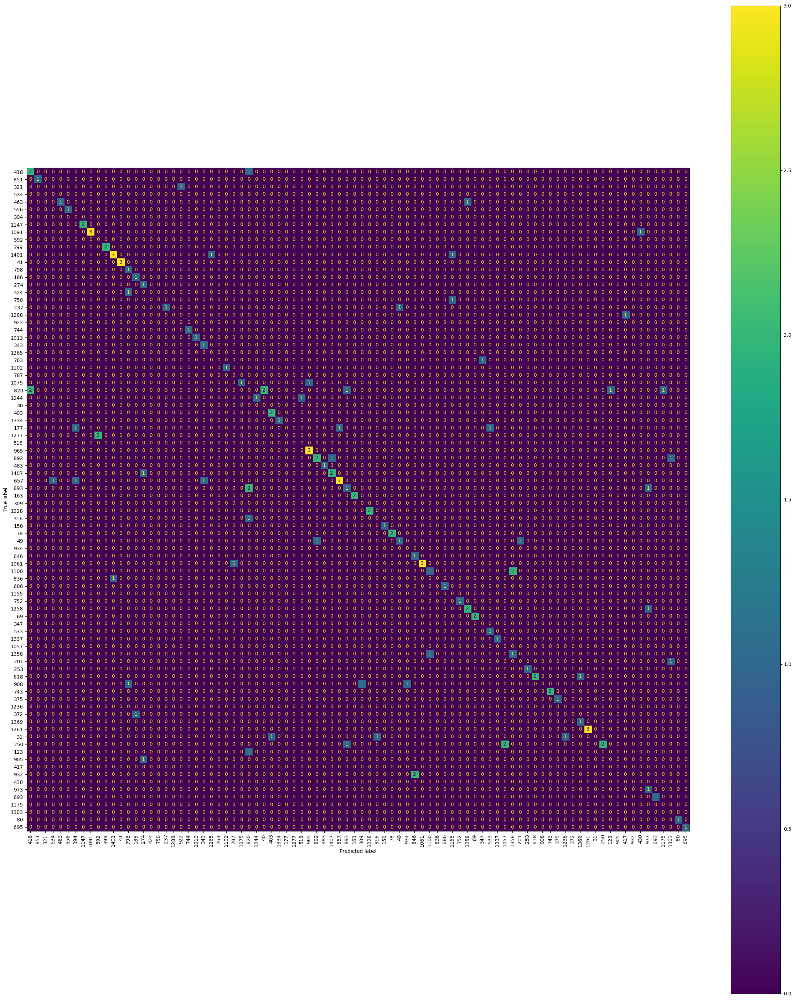

In [105]:
plot_confusion_matrix()